# Notebook for Project 1: EDA
Author: Sandra Schwegmann, Sandra.Schwegmann@gmx.net

This project is centered around exploratory data 
analysis (EDA) techniques and statistical analysis, 
as well as modeling data using linear regression.
Goal is to generate a model for house price prediction. Setting: A customer would like to buy a house whose price is within +/-20% of the average house price. It should have good conditions, 2-4 bedrooms and a size of 650-1000 square feet. Water-view is not necessary but would be nice, as would be vicinity to waterfront instead of waterview. The question is how individual parameters would influence the price and what kind of combination would suit the price expectations of the customer best.  

In [1]:
# import all necassary packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import statsmodels.formula.api as smf
import datetime
import plotly.express as px
from shapely.geometry import Point, MultiPoint
from shapely.ops import nearest_points

%matplotlib inline
plt.style.use('seaborn')
np.random.seed(42)

In [2]:
#load data
house_data = pd.read_csv('King_County_House_prices_dataset.csv')

## Variable description 
* **id** - unique identified for a house
* **date** - Date house was sold
* **price** -  Price is prediction target
* **bedrooms** -  Number of Bedrooms/House
* **bathrooms** -  Number of bathrooms/bedrooms
* **sqft_living** - square footage of the home
* **sqft_lot** - square footage of the lot
* **floors** - Total floors (levels in house)
* **waterfront** - House which has a view to a waterfront
* **view** - Has been viewed
* **condition** - How good the condition is ( Overall )
* **grade** - overall grade given to the housing unit, based on King County grading system
* **sqft_above** - square footage of house apart from basement
* **sqft_basement** - square footage of the basement
* **yr_built** - Built Year
* **yr_renovated** - Year when house was renovated
* **zipcode** - zip
* **lat** - Latitude coordinate
* **long** - Longitude coordinate
* **sqft_living15** - The square footage of interior housing living space for the nearest 15 neighbors
* **sqft_lot15** - The square footage of the land lots of the nearest 15 neighbors
* **basement2** - square footage of the basement cleaned up for missing values and '?'
* **log_Price** natural logarithm of price
* **dist2wf** - proxy for distance to waterline
* **hasBasement** - weather an object has an basement or not
* **hasBeenRenRec** - 1 if house has been renovated after 1987 or 0 if not
* **yr_renovated_rpl_0** - yr_renovated but cleaned up for NaN and 0 values (set to year of built)
* **sqft_liv2lot** - ration of living area  / lot area
* **isNew** - 1 if house was built after 1987, 0 when house was built before 1988
* **hasGoodConditions** - weather conditions are equal to or above 3 or rather be below 

## Type of data and data conversions

In [3]:
# Getting a first idea of the data
print('Number of rows and columns data: ',house_data.shape)
house_data.head(3)

Number of rows and columns data:  (21597, 21)


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,...,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,...,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,0.0,0.0,...,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062


In [4]:
house_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
id               21597 non-null int64
date             21597 non-null object
price            21597 non-null float64
bedrooms         21597 non-null int64
bathrooms        21597 non-null float64
sqft_living      21597 non-null int64
sqft_lot         21597 non-null int64
floors           21597 non-null float64
waterfront       19221 non-null float64
view             21534 non-null float64
condition        21597 non-null int64
grade            21597 non-null int64
sqft_above       21597 non-null int64
sqft_basement    21597 non-null object
yr_built         21597 non-null int64
yr_renovated     17755 non-null float64
zipcode          21597 non-null int64
lat              21597 non-null float64
long             21597 non-null float64
sqft_living15    21597 non-null int64
sqft_lot15       21597 non-null int64
dtypes: float64(8), int64(11), object(2)
memory usage: 3.5+ MB


In [5]:
house_data.sqft_basement.head(10)

0       0.0
1     400.0
2       0.0
3     910.0
4       0.0
5    1530.0
6         ?
7       0.0
8     730.0
9       0.0
Name: sqft_basement, dtype: object

In [6]:
# replace ? by NaN in house_data.sqft_basement
house_data.sqft_basement[house_data.sqft_basement=='?'] = np.nan

# create a new column for a numeric sqft_basement and converting from type object
# to type float

house_data['sqft_basement2'] = pd.to_numeric(house_data.sqft_basement)
#https://stackoverflow.com/questions/25952790/convert-pandas-series-from-dtype-object-to-float-and-errors-to-nans
house_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 22 columns):
id                21597 non-null int64
date              21597 non-null object
price             21597 non-null float64
bedrooms          21597 non-null int64
bathrooms         21597 non-null float64
sqft_living       21597 non-null int64
sqft_lot          21597 non-null int64
floors            21597 non-null float64
waterfront        19221 non-null float64
view              21534 non-null float64
condition         21597 non-null int64
grade             21597 non-null int64
sqft_above        21597 non-null int64
sqft_basement     21143 non-null object
yr_built          21597 non-null int64
yr_renovated      17755 non-null float64
zipcode           21597 non-null int64
lat               21597 non-null float64
long              21597 non-null float64
sqft_living15     21597 non-null int64
sqft_lot15        21597 non-null int64
sqft_basement2    21143 non-null float64
dtypes: float

/Users/sandra/opt/anaconda3/envs/nf/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [7]:
house_data.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,sqft_basement2
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,...,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650,0.0
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,...,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639,400.0
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,0.0,0.0,...,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062,0.0
3,2487200875,12/9/2014,604000.0,4,3.00,1960,5000,1.0,0.0,0.0,...,1050,910.0,1965,0.0,98136,47.5208,-122.393,1360,5000,910.0
4,1954400510,2/18/2015,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,...,1680,0.0,1987,0.0,98074,47.6168,-122.045,1800,7503,0.0


In [8]:
# convert date into pandas date-format
house_data['formatted_date'] = pd.to_datetime(house_data.date, format='%m/%d/%Y')

#create a counter for days since 01/05/2014
basedate  = pd.Timestamp('2014-05-01')
house_data['dateIndex'] = (house_data['formatted_date']-basedate).dt.days
house_data[['formatted_date','dateIndex']].head()

,formatted_date,dateIndex
0,2014-10-13,165
1,2014-12-09,222
2,2015-02-25,300
3,2014-12-09,222
4,2015-02-18,293


In [9]:
#have a look where data are located
fig = px.density_mapbox(house_data,
                        lat='lat',
                        lon='long',
                        z='price',
                        radius=5,
                        color_continuous_scale="Jet" ,
                        center=dict(lat=47.53, lon=-122.23),
                        zoom=7,
                        mapbox_style="open-street-map")
fig.write_html("figures/map_price.html")
fig.show()

In [10]:
fig = px.density_mapbox(house_data,
                        lat='lat',
                        lon='long',
                        z='zipcode',
                        radius=5,
                        color_continuous_scale="electric" ,
                        center=dict(lat=47.53, lon=-122.23),
                        zoom=7,
                        mapbox_style="open-street-map")
fig.write_html("figures/map_zipcode.html")
fig.show()

## Missing data treatment

In [11]:
missing = pd.DataFrame(house_data.isnull().sum(),columns=['Number'])
missing['Percentage'] = round(missing.Number/house_data.shape[0]*100,1)
missing[missing.Number!=0]

,Number,Percentage
waterfront,2376,11.0
view,63,0.3
sqft_basement,454,2.1
yr_renovated,3842,17.8
sqft_basement2,454,2.1


**Out of 27 variables 4 have missing values**
- waterfront has 2376 null values or 11 per cent of instances
- view has 63 instances of 0.3 percent missing values
- yr_renovated has 3842 missing values which is equal to 17.8 percent
- sqft_basement=sqft_basement2 has 454 instances or 2.1 percent of missing values

In [12]:
house_data[['view','waterfront']].describe()

,view,waterfront
count,21534.000000,19221.000000
mean,0.233863,0.007596
std,0.765686,0.086825
min,0.000000,0.000000
25%,0.000000,0.000000
50%,0.000000,0.000000
75%,0.000000,0.000000
max,4.000000,1.000000


### Renovation year

Year of renovation has two kinds of missing values
- NaN
- 0

In [13]:
#clean up yr_renovated, first set NaN to 0.0
house_data['yr_renovated_rpl_0'] = house_data.yr_renovated
house_data['yr_renovated_rpl_0'].fillna(0,inplace=True)

# then set 0.0 to yr_built as I assume that no renovation took place
# alternatively it should be tested weather categorizing data into 
# recently, unknown, never, not recently makes sense

house_data.yr_renovated_rpl_0[house_data.yr_renovated_rpl_0 == 0.0] \
    = house_data.yr_built[house_data.yr_renovated_rpl_0 == 0.0]
house_data[['yr_renovated_rpl_0','yr_renovated']].head()

/Users/sandra/opt/anaconda3/envs/nf/lib/python3.6/site-packages/ipykernel_launcher.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



,yr_renovated_rpl_0,yr_renovated
0,1955.0,0.0
1,1991.0,1991.0
2,1933.0,NaN
3,1965.0,0.0
4,1987.0,0.0


In [14]:
house_data[['yr_renovated_rpl_0','yr_renovated']].describe()

,yr_renovated_rpl_0,yr_renovated
count,21597.000000,17755.000000
mean,1972.945131,83.636778
std,28.945393,399.946414
min,1900.000000,0.000000
25%,1954.000000,0.000000
50%,1977.000000,0.000000
75%,1999.000000,0.000000
max,2015.000000,2015.000000


### Basement size

**total living area is the sum of area basement and area above**

In [15]:
house_data[['sqft_basement','sqft_above','sqft_living']].head(10)

,sqft_basement,sqft_above,sqft_living
0,0.0,1180,1180
1,400.0,2170,2570
2,0.0,770,770
3,910.0,1050,1960
4,0.0,1680,1680
5,1530.0,3890,5420
6,NaN,1715,1715
7,0.0,1060,1060
8,730.0,1050,1780
9,0.0,1890,1890


In [16]:
# removing missing data in sqft_basement2
house_data.sqft_basement2 = house_data.sqft_living - house_data.sqft_above
house_data[['sqft_basement','sqft_basement2','sqft_above','sqft_living']].head(7)

,sqft_basement,sqft_basement2,sqft_above,sqft_living
0,0.0,0,1180,1180
1,400.0,400,2170,2570
2,0.0,0,770,770
3,910.0,910,1050,1960
4,0.0,0,1680,1680
5,1530.0,1530,3890,5420
6,NaN,0,1715,1715


### View and Waterfront

**No solution found so far**
- no obvious relationship to other variables -> hard to estimate 

In [471]:
# was mit waterfront und view machen???

## Basic statistics

In [17]:
house_data.describe().round(2)

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,sqft_basement2,dateIndex,yr_renovated_rpl_0
count,2.159700e+04,21597.00,21597.00,21597.00,21597.00,21597.00,21597.00,19221.00,21534.00,21597.00,...,21597.00,17755.00,21597.00,21597.00,21597.00,21597.00,21597.00,21597.00,21597.00,21597.00
mean,4.580474e+09,540296.57,3.37,2.12,2080.32,15099.41,1.49,0.01,0.23,3.41,...,1971.00,83.64,98077.95,47.56,-122.21,1986.62,12758.28,291.73,181.18,1972.95
std,2.876736e+09,367368.14,0.93,0.77,918.11,41412.64,0.54,0.09,0.77,0.65,...,29.38,399.95,53.51,0.14,0.14,685.23,27274.44,442.67,113.06,28.95
min,1.000102e+06,78000.00,1.00,0.50,370.00,520.00,1.00,0.00,0.00,1.00,...,1900.00,0.00,98001.00,47.16,-122.52,399.00,651.00,0.00,1.00,1900.00
25%,2.123049e+09,322000.00,3.00,1.75,1430.00,5040.00,1.00,0.00,0.00,3.00,...,1951.00,0.00,98033.00,47.47,-122.33,1490.00,5100.00,0.00,82.00,1954.00
50%,3.904930e+09,450000.00,3.00,2.25,1910.00,7618.00,1.50,0.00,0.00,3.00,...,1975.00,0.00,98065.00,47.57,-122.23,1840.00,7620.00,0.00,168.00,1977.00
75%,7.308900e+09,645000.00,4.00,2.50,2550.00,10685.00,2.00,0.00,0.00,4.00,...,1997.00,0.00,98118.00,47.68,-122.12,2360.00,10083.00,560.00,292.00,1999.00
max,9.900000e+09,7700000.00,33.00,8.00,13540.00,1651359.00,3.50,1.00,4.00,5.00,...,2015.00,2015.00,98199.00,47.78,-121.32,6210.00,871200.00,4820.00,391.00,2015.00


In [18]:
house_data[house_data.bedrooms> 10]

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,sqft_basement2,formatted_date,dateIndex,yr_renovated_rpl_0
8748,1773100755,8/21/2014,520000.0,11,3.00,3000,4960,2.0,0.0,0.0,...,1999.0,98106,47.5560,-122.363,1420,4960,600,2014-08-21,112,1999.0
15856,2402100895,6/25/2014,640000.0,33,1.75,1620,6000,1.0,0.0,0.0,...,0.0,98103,47.6878,-122.331,1330,4700,580,2014-06-25,55,1947.0


In [19]:
# delete data point with 33 rooms -> is not representative and seems to be unrealistic: 
#150sqm for 33 bedrooms + kitchen plus bathrooms means that every room is max 4sqm in 
#size = 2x2 m. Could be, but could also be a typing error
house_data= house_data.drop(house_data[house_data.bedrooms== 33].index)
house_data[house_data.bedrooms> 10]

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,sqft_basement2,formatted_date,dateIndex,yr_renovated_rpl_0
8748,1773100755,8/21/2014,520000.0,11,3.0,3000,4960,2.0,0.0,0.0,...,1999.0,98106,47.556,-122.363,1420,4960,600,2014-08-21,112,1999.0


In [20]:
# calculate the natural log! reverse with e^x
house_data['log_Price'] = np.log(house_data.price)
house_data['sq_sqft_liv'] = house_data.sqft_living*house_data.sqft_living
house_data.log_Price.head()

0    12.309982
1    13.195614
2    12.100712
3    13.311329
4    13.142166
Name: log_Price, dtype: float64

## Correlation

In [21]:
continuous_var = list(house_data.select_dtypes(
                        ['int64','float64']).columns.values)
continuous_var.remove('id')


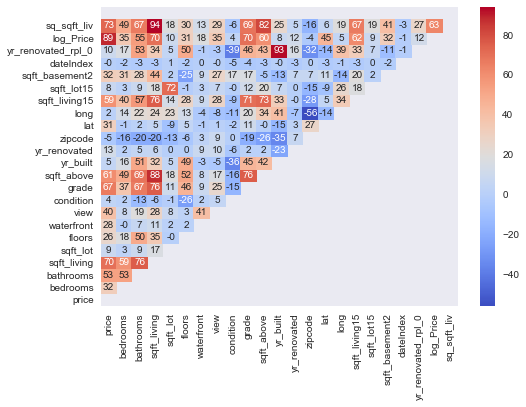

In [22]:
X_dum=pd.get_dummies(house_data[continuous_var].copy())
mask = np.triu(X_dum.corr())
ax = sns.heatmap(round(X_dum.corr()*100,0)
                 ,annot=True
                 ,mask=mask
                 ,cmap='coolwarm')


ax.set_ylim((0,24))
plt.savefig('figures/correlogram.png')

In [23]:
house_data[['sqft_living','grade','sqft_above','sqft_basement2','sqft_living15',\
            'bathrooms','view','sqft_lot']].describe()

,sqft_living,grade,sqft_above,sqft_basement2,sqft_living15,bathrooms,view,sqft_lot
count,21596.000000,21596.000000,21596.000000,21596.000000,21596.000000,21596.000000,21533.000000,2.159600e+04
mean,2080.343165,7.657946,1788.631506,291.711660,1986.650722,2.115843,0.233874,1.509983e+04
std,918.122038,1.173218,827.763251,442.673703,685.231768,0.768998,0.765702,4.141355e+04
min,370.000000,3.000000,370.000000,0.000000,399.000000,0.500000,0.000000,5.200000e+02
25%,1430.000000,7.000000,1190.000000,0.000000,1490.000000,1.750000,0.000000,5.040000e+03
50%,1910.000000,7.000000,1560.000000,0.000000,1840.000000,2.250000,0.000000,7.619000e+03
75%,2550.000000,8.000000,2210.000000,560.000000,2360.000000,2.500000,0.000000,1.068550e+04
max,13540.000000,13.000000,9410.000000,4820.000000,6210.000000,8.000000,4.000000,1.651359e+06


**Some remarks to the features mostly influencing the price:**
- sqft_above is never 0 but sqft_basement is -> create categories?
- grade, bathrooms, view = categorical variables
- why is bathroom more important than bedrooms???

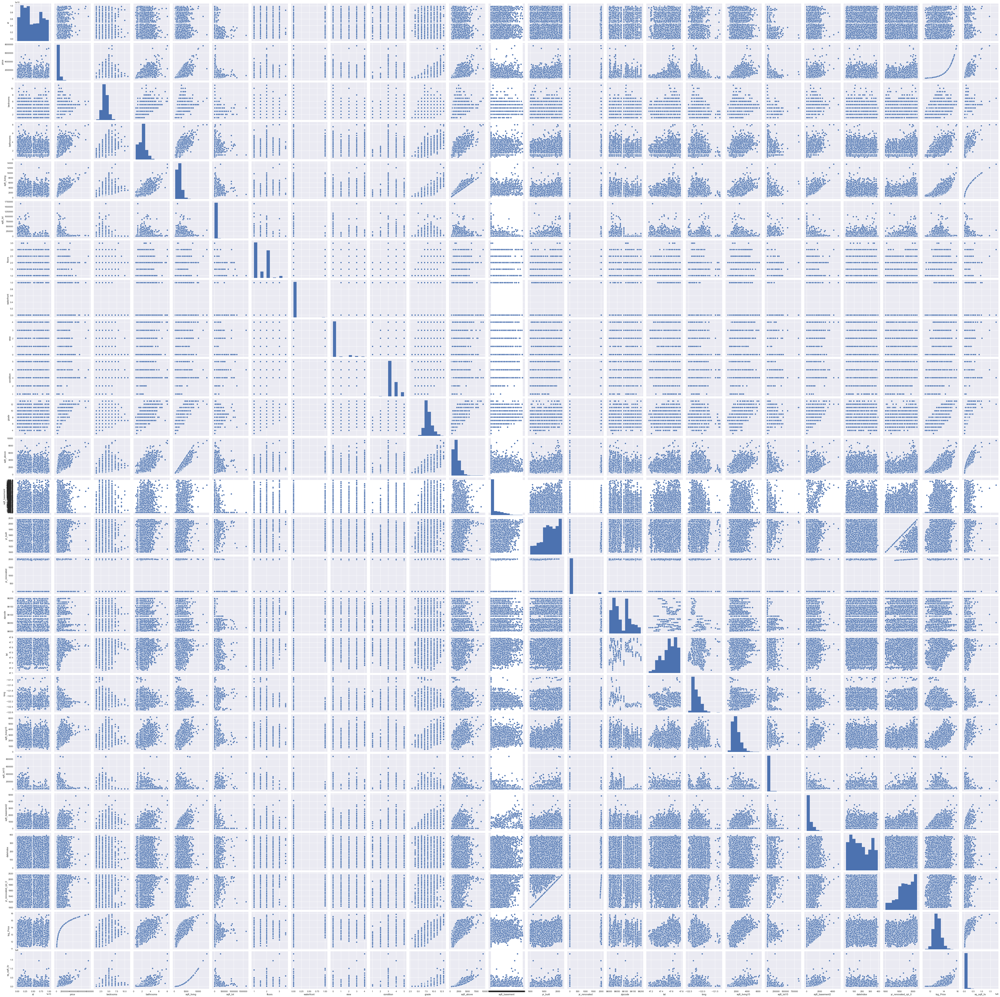

In [24]:
# a look onto relationships in the data
sns.pairplot(house_data)
plt.savefig('figures/pairplot.png')

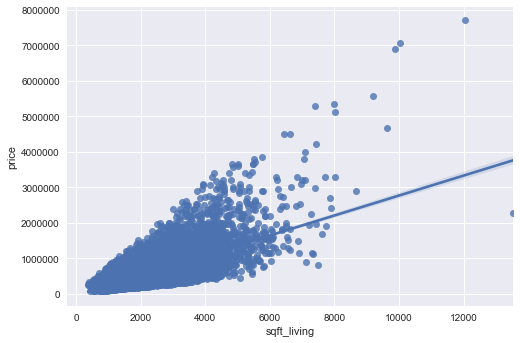

In [25]:
#take a closer look into area-price relationship
sns.regplot(x=house_data.sqft_living,y = house_data.price);
plt.savefig('figures/sqft_lining_Price_scatter.png')


## Histograms

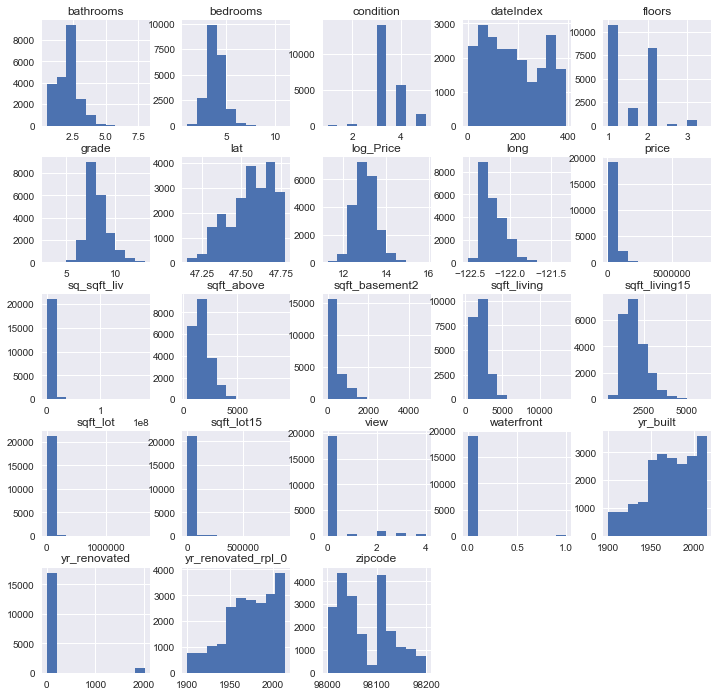

In [26]:
_ = X_dum.hist(figsize=(12,12))
plt.savefig('figures/hist_all.png')

# Individual Variables relevant for pricing

## General view

In [27]:
explanatory_vars = list(house_data.columns)
explanatory_vars = [e for e in explanatory_vars 
                   if e not in ('id','date','sqft_basement')]
explanatory_vars 

['price',
 'bedrooms',
 'bathrooms',
 'sqft_living',
 'sqft_lot',
 'floors',
 'waterfront',
 'view',
 'condition',
 'grade',
 'sqft_above',
 'yr_built',
 'yr_renovated',
 'zipcode',
 'lat',
 'long',
 'sqft_living15',
 'sqft_lot15',
 'sqft_basement2',
 'formatted_date',
 'dateIndex',
 'yr_renovated_rpl_0',
 'log_Price',
 'sq_sqft_liv']

In [28]:
var_list  = ['bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15', 'sq_sqft_liv']

#regression summary for the above listed variables and price
for expl_var in var_list:
    model = 'price ~ {:}'.format(expl_var)
    print(smf.ols(formula=model, data=house_data).fit().summary())
    print()
    print('**************************************************************************************')
    print()

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.100
Model:                            OLS   Adj. R-squared:                  0.100
Method:                 Least Squares   F-statistic:                     2395.
Date:                Sun, 14 Jun 2020   Prob (F-statistic):               0.00
Time:                        20:06:02   Log-Likelihood:            -3.0624e+05
No. Observations:               21596   AIC:                         6.125e+05
Df Residuals:                   21594   BIC:                         6.125e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   1.074e+05   9158.506     11.726      0.0

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.017
Model:                            OLS   Adj. R-squared:                  0.017
Method:                 Least Squares   F-statistic:                     303.3
Date:                Sun, 14 Jun 2020   Prob (F-statistic):           2.32e-67
Time:                        20:06:02   Log-Likelihood:            -2.5264e+05
No. Observations:               17754   AIC:                         5.053e+05
Df Residuals:                   17752   BIC:                         5.053e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
Intercept     5.306e+05   2807.841    188.987   

In [29]:
for expl_var in var_list:
    model = 'price ~ {:}'.format(expl_var)
    rs = smf.ols(formula=model, data=house_data).fit().rsquared
    print('{:7s} \t \t= {:.3}'.format(expl_var, rs))

bedrooms 	 	= 0.0998
bathrooms 	 	= 0.277
sqft_living 	 	= 0.493
sqft_lot 	 	= 0.00808
floors  	 	= 0.066
waterfront 	 	= 0.0763
view    	 	= 0.157
condition 	 	= 0.0013
grade   	 	= 0.446
sqft_above 	 	= 0.366
yr_built 	 	= 0.00291
yr_renovated 	 	= 0.0168
zipcode 	 	= 0.00285
lat     	 	= 0.0941
long    	 	= 0.000486
sqft_living15 	 	= 0.343
sqft_lot15 	 	= 0.00686
sq_sqft_liv 	 	= 0.529


**highest $r^2$**
- bathrooms 	 	= 0.277
- sqft_living 	 	= 0.493
- view    	 	    = 0.157
- grade   	 	    = 0.446
- sqft_above 	 	= 0.366
- sqft_basement 	= 0.202
- sqft_living15 	= 0.343

**highest impact according to correlogram**
- sqft_living having $r^2$ = 0.493
- grade having $r^2$ = 0.446
- sqft_above having $r^2$ = 0.366
- sqft_living15 having $r^2$ = 0.343
- bathroom having $r^2$ = 0.277
- view having $r^2$ = 0.157

In [30]:
#regression summary for the above listed variables and log_Price
for expl_var in var_list:
    model = 'log_Price ~ {:}'.format(expl_var)
    print(smf.ols(formula=model, data=house_data).fit().summary())
    print()
    print('**************************************************************************************')
    print()

                            OLS Regression Results                            
Dep. Variable:              log_Price   R-squared:                       0.123
Model:                            OLS   Adj. R-squared:                  0.123
Method:                 Least Squares   F-statistic:                     3032.
Date:                Sun, 14 Jun 2020   Prob (F-statistic):               0.00
Time:                        20:06:08   Log-Likelihood:                -15373.
No. Observations:               21596   AIC:                         3.075e+04
Df Residuals:                   21594   BIC:                         3.077e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     12.3592      0.013    953.927      0.0

                            OLS Regression Results                            
Dep. Variable:              log_Price   R-squared:                       0.014
Model:                            OLS   Adj. R-squared:                  0.014
Method:                 Least Squares   F-statistic:                     251.5
Date:                Sun, 14 Jun 2020   Prob (F-statistic):           3.04e-56
Time:                        20:06:08   Log-Likelihood:                -13653.
No. Observations:               17754   AIC:                         2.731e+04
Df Residuals:                   17752   BIC:                         2.733e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
Intercept       13.0360      0.004   3256.418   

In [31]:

for expl_var in var_list:
    model = 'log_Price ~ {:}'.format(expl_var)
    rs = smf.ols(formula=model, data=house_data).fit().rsquared
    print('{:7s} \t \t= {:.3}'.format(expl_var, rs))

bedrooms 	 	= 0.123
bathrooms 	 	= 0.304
sqft_living 	 	= 0.483
sqft_lot 	 	= 0.01
floors  	 	= 0.0965
waterfront 	 	= 0.0326
view    	 	= 0.119
condition 	 	= 0.00151
grade   	 	= 0.495
sqft_above 	 	= 0.362
yr_built 	 	= 0.0065
yr_renovated 	 	= 0.014
zipcode 	 	= 0.00151
lat     	 	= 0.201
long    	 	= 0.00259
sqft_living15 	 	= 0.384
sqft_lot15 	 	= 0.00852
sq_sqft_liv 	 	= 0.399


In [35]:
house_data.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15', 'sqft_basement2',
       'formatted_date', 'dateIndex', 'yr_renovated_rpl_0', 'log_Price',
       'sq_sqft_liv'],
      dtype='object')

## The renovation issue

In [32]:
# the pure data without NaNs
x = house_data.yr_renovated[house_data.yr_renovated >= 0.0]
x = sm.add_constant(x)
y = house_data.price[house_data.yr_renovated >= 0.0]
print(len(x))
sm.OLS(y,x).fit().summary()

17754


/Users/sandra/opt/anaconda3/envs/nf/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.



<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.017
Model:                            OLS   Adj. R-squared:                  0.017
Method:                 Least Squares   F-statistic:                     303.3
Date:                Sun, 14 Jun 2020   Prob (F-statistic):           2.32e-67
Time:                        20:06:13   Log-Likelihood:            -2.5264e+05
No. Observations:               17754   AIC:                         5.053e+05
Df Residuals:                   17752   BIC:                         5.053e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
================================================================================
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const         5.306e+05   2807.841    188.987      0.000    5.25e+05    5.36e+05
yr_renovated   119.6720      6.872     17.415      0.000     106.202     133.142
==============================================================================
Omnibus:                    15959.354   Durbin-Watson:                   1.956
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1018792.138
Skew:                           4.100   Prob(JB):                         0.00
Kurtosis:                      39.194   Cond. No.                         417.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [37]:
# Testing all values > 0
x = house_data.yr_renovated[house_data.yr_renovated > 0.0]
x = sm.add_constant(x)
y = house_data.price[house_data.yr_renovated > 0.0]
print(len(x))
sm.OLS(y,x).fit().summary()


744


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.016
Model:                            OLS   Adj. R-squared:                  0.014
Method:                 Least Squares   F-statistic:                     11.87
Date:                Wed, 10 Jun 2020   Prob (F-statistic):           0.000601
Time:                        07:19:47   Log-Likelihood:                -10981.
No. Observations:                 744   AIC:                         2.197e+04
Df Residuals:                     742   BIC:                         2.197e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
================================================================================
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const        -9.301e+06   2.92e+06     -3.183      0.002    -1.5e+07   -3.56e+06
yr_renovated  5045.1286   1464.139      3.446      0.001    2170.780    7919.477
==============================================================================
Omnibus:                      753.148   Durbin-Watson:                   2.082
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            46310.556
Skew:                           4.569   Prob(JB):                         0.00
Kurtosis:                      40.555   Cond. No.                     2.56e+05
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.56e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

**only 744 values have the information weather houses were renovated**

In [33]:
fig = px.density_mapbox(house_data,
                        lat='lat',
                        lon='long',
                        z='yr_renovated_rpl_0',
                        radius=5,
                        color_continuous_scale="electric" ,
                        center=dict(lat=47.53, lon=-122.23),
                        zoom=7,
                        mapbox_style="open-street-map")
fig.write_html("figures/map_yr_renovated_rpl_0.html")
fig.show()

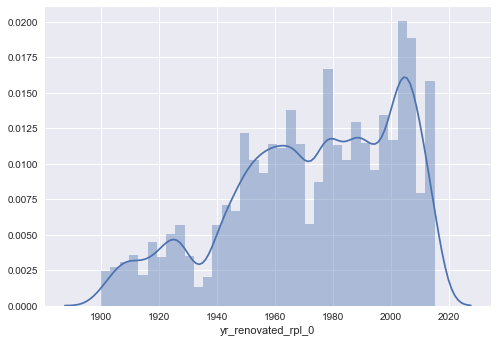

In [34]:
# distribution of renovation years after settin 0 and NaN to year of built
sns.distplot(house_data.yr_renovated_rpl_0)
plt.savefig('figures/hist_yr_renovated_rpl_0.png')

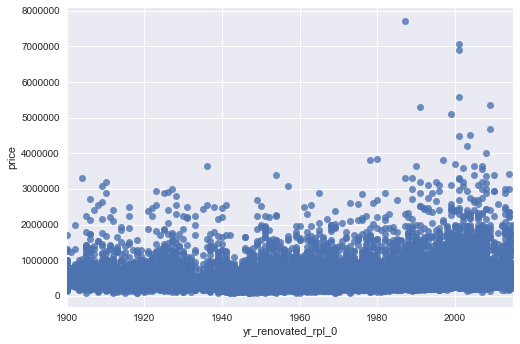

In [35]:
sns.regplot(x='yr_renovated_rpl_0',y = 'price', data= house_data)

In [36]:
smf.ols(formula='price ~ yr_renovated_rpl_0', data=house_data).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.010
Model:                            OLS   Adj. R-squared:                  0.009
Method:                 Least Squares   F-statistic:                     207.5
Date:                Sun, 14 Jun 2020   Prob (F-statistic):           8.03e-47
Time:                        20:06:27   Log-Likelihood:            -3.0727e+05
No. Observations:               21596   AIC:                         6.146e+05
Df Residuals:                   21594   BIC:                         6.146e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Intercept          -1.903e+06    1.7e+05    -11.217      0.000   -2.23e+06   -1.57e+06
yr_renovated_rpl_0  1238.1542     85.958     14.404      0.000    1069.670    1406.638
==============================================================================
Omnibus:                    19088.547   Durbin-Watson:                   1.974
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1128183.185
Skew:                           4.019   Prob(JB):                         0.00
Kurtosis:                      37.484   Cond. No.                     1.35e+05
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.35e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [37]:
smf.ols(formula='price ~ yr_renovated', data=house_data).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.017
Model:                            OLS   Adj. R-squared:                  0.017
Method:                 Least Squares   F-statistic:                     303.3
Date:                Sun, 14 Jun 2020   Prob (F-statistic):           2.32e-67
Time:                        20:06:29   Log-Likelihood:            -2.5264e+05
No. Observations:               17754   AIC:                         5.053e+05
Df Residuals:                   17752   BIC:                         5.053e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
================================================================================
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
Intercept     5.306e+05   2807.841    188.987      0.000    5.25e+05    5.36e+05
yr_renovated   119.6720      6.872     17.415      0.000     106.202     133.142
==============================================================================
Omnibus:                    15959.354   Durbin-Watson:                   1.956
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1018792.138
Skew:                           4.100   Prob(JB):                         0.00
Kurtosis:                      39.194   Cond. No.                         417.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

**Summary:** 
- without removing 0.0 values, $r^2$ is even higher than having them removed...

## Bedrooms 

### The Room issue

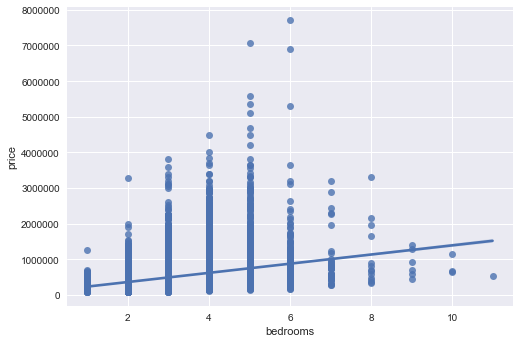

In [38]:
sns.regplot(x='bedrooms',y = 'price', data= house_data);

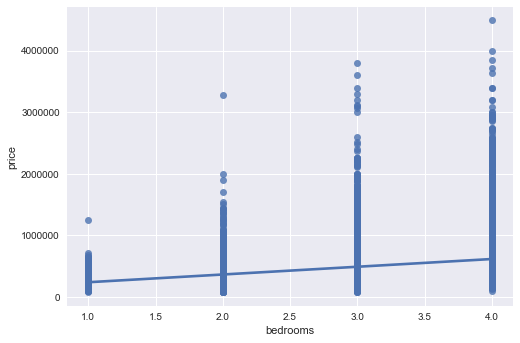

In [39]:
#nice plots and correlation considering only up to five and from 5 to more bedrooms
xval = house_data.bedrooms[house_data.bedrooms <5]
yval = house_data.price[house_data.bedrooms <5]
sns.regplot(x=xval,y = yval);
plt.savefig('figures/rooms_up2four.png')

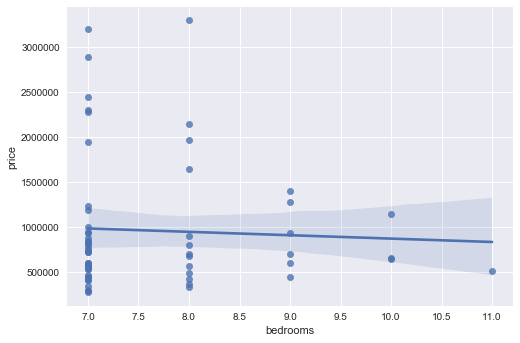

In [40]:
#nice plots and correlation considering only up to five and from 5 to more bedrooms
xval = house_data.bedrooms[house_data.bedrooms >6]
yval = house_data.price[house_data.bedrooms >6]
sns.regplot(x=xval,y = yval);

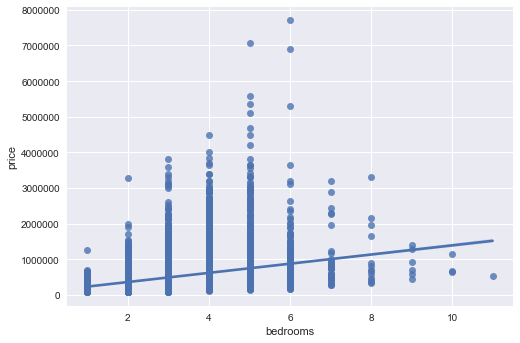

In [41]:
#obsolet after having removed the outlyer...
bedrooms_filtered = house_data.bedrooms[house_data.bedrooms <30]
price_filtered = house_data.price[house_data.bedrooms <30]
sns.regplot(x=bedrooms_filtered,y = price_filtered);

- outlayer has nearly no impact -> not visible here since outlayer has been taken out
- from 1 to 4 bedrooms, price increases with increasing num of rooms, from 7 to 11 bedrooms price seems to decrease by increasing room numbers

### Many rooms vs less rooms

In [42]:
# create a dummy for has many rooms, means more than 5 rooms
house_data['hasManyRooms'] = 0
house_data.hasManyRooms[house_data.bedrooms > 5] = 1
house_data['hasLessRooms'] = 1
house_data.hasLessRooms[house_data.bedrooms > 5] = 0

print(smf.ols(formula='log_Price ~ hasManyRooms', data=house_data).fit().rsquared)
print(smf.ols(formula='log_Price ~ hasLessRooms', data=house_data).fit().rsquared)
print(smf.ols(formula='log_Price ~ bedrooms', data=house_data).fit().rsquared)

0.008464003027105704
0.008464003027105593
0.12311072078241969


/Users/sandra/opt/anaconda3/envs/nf/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

/Users/sandra/opt/anaconda3/envs/nf/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



**- hasMany/LessRooms is not a good predictor, bedrooms by itself is better**

In [43]:
#maybe room dummies are better
Room_dum = pd.get_dummies(house_data.bedrooms,prefix='Rooms')
jh_room_data = house_data.join(Room_dum)
Room_dum.head()

,Rooms_1,Rooms_2,Rooms_3,Rooms_4,Rooms_5,Rooms_6,Rooms_7,Rooms_8,Rooms_9,Rooms_10,Rooms_11
0,0,0,1,0,0,0,0,0,0,0,0
1,0,0,1,0,0,0,0,0,0,0,0
2,0,1,0,0,0,0,0,0,0,0,0
3,0,0,0,1,0,0,0,0,0,0,0
4,0,0,1,0,0,0,0,0,0,0,0


In [44]:
house_data = jh_room_data
for item in Room_dum:
    model = 'log_Price ~ {:}'.format(item)
    rs = smf.ols(formula=model, data=jh_room_data).fit().rsquared
    print('{:7s} \t \t= {:.3}'.format(item, rs))

Rooms_1 	 	= 0.00762
Rooms_2 	 	= 0.0327
Rooms_3 	 	= 0.0374
Rooms_4 	 	= 0.0513
Rooms_5 	 	= 0.0336
Rooms_6 	 	= 0.00584
Rooms_7 	 	= 0.00158
Rooms_8 	 	= 0.000798
Rooms_9 	 	= 0.000332
Rooms_10 	 	= 0.000142
Rooms_11 	 	= 2.15e-06


**not really: number of rooms is a better predictor than room dummies and hasMany/hasLessRooms are**

## Categories

### Grade

In [45]:
#create dummie for grade 
Grade_dum = pd.get_dummies(house_data.grade,prefix='Grade')
Grade_dum.head()

,Grade_3,Grade_4,Grade_5,Grade_6,Grade_7,Grade_8,Grade_9,Grade_10,Grade_11,Grade_12,Grade_13
0,0,0,0,0,1,0,0,0,0,0,0
1,0,0,0,0,1,0,0,0,0,0,0
2,0,0,0,1,0,0,0,0,0,0,0
3,0,0,0,0,1,0,0,0,0,0,0
4,0,0,0,0,0,1,0,0,0,0,0


In [46]:
jh_grade = house_data.join(Grade_dum)
house_data = jh_grade

In [47]:
for item in Grade_dum:
    model = 'price ~ {:}'.format(item)
    rs = smf.ols(formula=model, data=house_data).fit().rsquared
    print('{:7s} \t \t= {:.3}'.format(item, rs))

Grade_3 	 	= 2.66e-05
Grade_4 	 	= 0.001
Grade_5 	 	= 0.00715
Grade_6 	 	= 0.0439
Grade_7 	 	= 0.0999
Grade_8 	 	= 2.1e-05
Grade_9 	 	= 0.0556
Grade_10 	 	= 0.116
Grade_11 	 	= 0.128
Grade_12 	 	= 0.0847
Grade_13 	 	= 0.0449


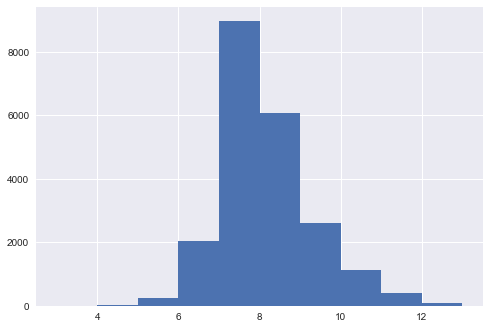

In [48]:
house_data.grade.hist()

In [ ]:
## to do: categorise grade into bad medium and high!!!

### View

In [49]:
#create dummies for view
View_dum = pd.get_dummies(house_data.view,prefix='View')
View_dum.rename(columns={'View_0.0':'View_0',
                        'View_1.0':'View_1',
                        'View_2.0':'View_2',
                        'View_3.0':'View_3',
                        'View_4.0':'View_4'}, inplace=True)
jh_view_data = house_data.join(View_dum)
View_dum.head()

,View_0,View_1,View_2,View_3,View_4
0,1,0,0,0,0
1,1,0,0,0,0
2,1,0,0,0,0
3,1,0,0,0,0
4,1,0,0,0,0


In [50]:
house_data = jh_view_data
for item in View_dum:
    model = 'price ~ {:}'.format(item)
    rs = smf.ols(formula=model, data=jh_view_data).fit().rsquared
    print('{:7s} \t \t= {:.3}'.format(item, rs))

View_0  	 	= 0.125
View_1  	 	= 0.00857
View_2  	 	= 0.0217
View_3  	 	= 0.0335
View_4  	 	= 0.0918


### Conditions

In [51]:
#create dummies for conditions
Condi_dum = pd.get_dummies(house_data.condition,prefix='Condi')
jh_conditions = house_data.join(Condi_dum)
house_data = jh_conditions

In [52]:
house_data.condition.describe()

count    21596.000000
mean         3.409752
std          0.650471
min          1.000000
25%          3.000000
50%          3.000000
75%          4.000000
max          5.000000
Name: condition, dtype: float64

In [53]:
for item in Condi_dum:
    model = 'log_Price ~ {:}'.format(item)
    rs = smf.ols(formula=model, data=house_data).fit().rsquared
    print('{:7s} \t \t= {:.3}'.format(item, rs))

Condi_1 	 	= 0.00139
Condi_2 	 	= 0.00741
Condi_3 	 	= 0.000483
Condi_4 	 	= 0.00166
Condi_5 	 	= 0.00373


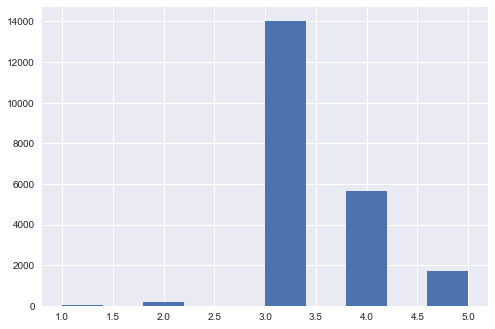

In [54]:
house_data.condition.hist()

In [55]:
#try to separate in good vs bad conditions dummies
house_data['hasGoodConditions'] = 0;
house_data.hasGoodConditions[house_data.condition >=3] = 1;
house_data.hasGoodConditions.describe()

/Users/sandra/opt/anaconda3/envs/nf/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



count    21596.000000
mean         0.990785
std          0.095552
min          0.000000
25%          1.000000
50%          1.000000
75%          1.000000
max          1.000000
Name: hasGoodConditions, dtype: float64

In [56]:
smf.ols(formula='log_Price ~ hasGoodConditions', data=house_data).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              log_Price   R-squared:                       0.009
Model:                            OLS   Adj. R-squared:                  0.009
Method:                 Least Squares   F-statistic:                     192.2
Date:                Sun, 14 Jun 2020   Prob (F-statistic):           1.65e-43
Time:                        20:07:19   Log-Likelihood:                -16696.
No. Observations:               21596   AIC:                         3.340e+04
Df Residuals:                   21594   BIC:                         3.341e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept            12.5354      0.037    337.310      0.000      12.463      12.608
hasGoodConditions     0.5176      0.037     13.862      0.000       0.444       0.591
==============================================================================
Omnibus:                      905.725   Durbin-Watson:                   1.958
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1151.498
Skew:                           0.449   Prob(JB):                    9.02e-251
Kurtosis:                       3.687   Cond. No.                         20.8
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

**has finally not a big impact...**

## New Variables

### Maximum distance to waterfront view

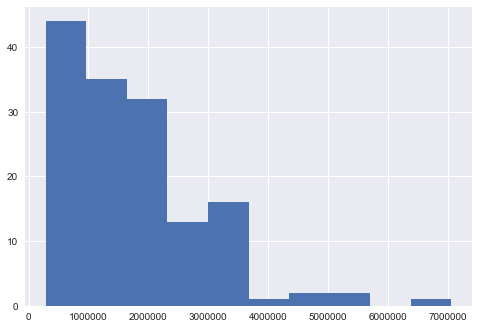

In [57]:
# how are prices distributed for waterview objects
xvals = house_data.price[house_data.waterfront==0]
yvals = house_data.price[house_data.waterfront==1]
yvals.hist()
#xvals.hist()

In [ ]:
# how are prices distributed for non-waterview objects

In [58]:
#get relevant information about area
house_data[['long','lat']].describe()

,long,lat
count,21596.000000,21596.000000
mean,-122.213977,47.560087
std,0.140725,0.138552
min,-122.519000,47.155900
25%,-122.328000,47.471100
50%,-122.231000,47.571800
75%,-122.125000,47.678000
max,-121.315000,47.777600


**boundary conditions** 
- lat varies from 47.56° to 47.78°N
- long varies from 122.21° to 121.32°W
- lat distorsion is neglected here for simplification since it is very small -> add later on

In [59]:
# create new data frame for calculations, calculate a proxy variable:
# distance to nearest object with having waterfront
df = pd.DataFrame(house_data[['id','log_Price','long','lat','waterfront']])
df['dist2wf'] = -1
df.dist2wf[df.waterfront == 1.0] = 0

newdf= pd.DataFrame(house_data[['id','log_Price','long','lat','waterfront']])
newdf['dist2wf'] = 0
newdf.dist2wf[newdf.waterfront == 1.0] = -1

newdf.sort_values(by='dist2wf',inplace=True,ascending=False)
newdf.head()

/Users/sandra/opt/anaconda3/envs/nf/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

/Users/sandra/opt/anaconda3/envs/nf/lib/python3.6/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



,id,log_Price,long,lat,waterfront,dist2wf
0,7129300520,12.309982,-122.257,47.5112,NaN,0
14367,723039189,13.159659,-122.467,47.5023,0.0,0
14375,1922059197,12.581079,-122.217,47.3746,0.0,0
14374,1796000120,13.142166,-122.088,47.3068,0.0,0
14373,7518503065,12.721886,-122.380,47.6821,0.0,0


**146 houses with waterfront**

In [60]:
#select houses with view and convert positions to tuples
tuple_long   = newdf.long[-146:].values
tuple_lat    = newdf.lat[-146:].values
pos_tup_list = []


In [61]:
for i in range(len(tuple_lat)): 
    pos_tup_list.append(Point(tuple_lat[i],tuple_long[i]))

In [62]:
df.shape

(21596, 6)

____________________________________________________________
**NOTE: next step may take ~30 minutes - only run if needed!**

In [63]:
# check for every data point with no waterfront or NaN distance to next waterfront object
# NOTE: data point 15856 has been removed => exclude! -> find another solution!!!!
# NOTE: Distance is calculated in meters -> change to miles or km
for j in range(15857,21596): 
    if df.dist2wf[j] == -1:
    #if j!= 15856 and df.dist2wf[j] == -1:
        orig     = Point(df.lat[j],df.long[j])
        dist_tup = MultiPoint(pos_tup_list)
        NPOI     = nearest_points(orig,dist_tup)
        # separate point object variables to a list of 2 numbers with format string
        newP     = str(NPOI[1])[7:-1].split()
    
        if j%1000 == 0: print(j)
        # now calculate distance of a house to next waterfront object
        x             = (df.long[j] - float(newP[1]))*111200
        y             = (df.lat[j] - float(newP[0]))*111200
        df.dist2wf[j] = np.sqrt(x*x + y*y)

/Users/sandra/opt/anaconda3/envs/nf/lib/python3.6/site-packages/ipykernel_launcher.py:17: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



16000
17000
18000
19000
20000
21000


______________________________________________

In [64]:
house_data= house_data.merge(df.dist2wf,on=df.index)
house_data.dist2wf = house_data.dist2wf/1000 # convert into km
house_data.head()

,key_0,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,...,View_2,View_3,View_4,Condi_1,Condi_2,Condi_3,Condi_4,Condi_5,hasGoodConditions,dist2wf
0,0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,...,0,0,0,0,0,1,0,0,1,-0.001
1,1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0.0,...,0,0,0,0,0,1,0,0,1,-0.001
2,2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,0.0,...,0,0,0,0,0,1,0,0,1,-0.001
3,3,2487200875,12/9/2014,604000.0,4,3.00,1960,5000,1.0,0.0,...,0,0,0,0,0,0,0,1,1,-0.001
4,4,1954400510,2/18/2015,510000.0,3,2.00,1680,8080,1.0,0.0,...,0,0,0,0,0,1,0,0,1,-0.001


In [65]:
house_data.dist2wf.describe()

count    21596.000000
mean         1.922047
std          5.050006
min         -0.001000
25%         -0.001000
50%         -0.001000
75%          0.896000
max         78.860000
Name: dist2wf, dtype: float64

In [66]:
#check r^2 log_Price Distance to waterfront
print(smf.ols(formula='log_Price ~ dist2wf', data=house_data).fit().rsquared)
print(smf.ols(formula='price ~ dist2wf', data=house_data).fit().rsquared)

0.0038513692662373034
0.00397094160276279


**$r^2$ by 0.02 higher compared to waterfront considering log_Price**



In [67]:
smf.ols(formula='log_Price ~ dist2wf', data=house_data).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              log_Price   R-squared:                       0.004
Model:                            OLS   Adj. R-squared:                  0.004
Method:                 Least Squares   F-statistic:                     83.49
Date:                Sun, 14 Jun 2020   Prob (F-statistic):           6.96e-20
Time:                        20:17:03   Log-Likelihood:                -16750.
No. Observations:               21596   AIC:                         3.350e+04
Df Residuals:                   21594   BIC:                         3.352e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     13.0606      0.004   3413.121      0.000      13.053      13.068
dist2wf       -0.0065      0.001     -9.137      0.000      -0.008      -0.005
==============================================================================
Omnibus:                      820.699   Durbin-Watson:                   1.946
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1048.867
Skew:                           0.418   Prob(JB):                    1.74e-228
Kurtosis:                       3.684   Cond. No.                         5.81
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [68]:
smf.ols(formula='price ~ dist2wf', data=house_data).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.004
Model:                            OLS   Adj. R-squared:                  0.004
Method:                 Least Squares   F-statistic:                     86.09
Date:                Sun, 14 Jun 2020   Prob (F-statistic):           1.88e-20
Time:                        20:17:04   Log-Likelihood:            -3.0733e+05
No. Observations:               21596   AIC:                         6.147e+05
Df Residuals:                   21594   BIC:                         6.147e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   5.491e+05   2669.607    205.687      0.000    5.44e+05    5.54e+05
dist2wf    -4584.2226    494.070     -9.278      0.000   -5552.636   -3615.809
==============================================================================
Omnibus:                    19079.970   Durbin-Watson:                   1.960
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1132236.733
Skew:                           4.014   Prob(JB):                         0.00
Kurtosis:                      37.552   Cond. No.                         5.81
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

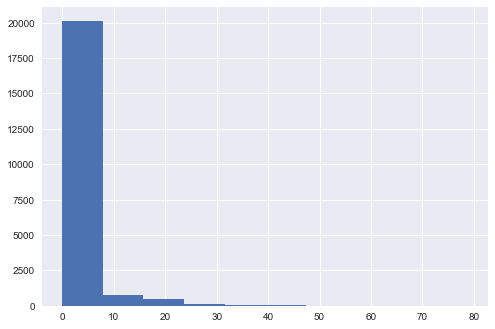

In [69]:
house_data.dist2wf.hist()

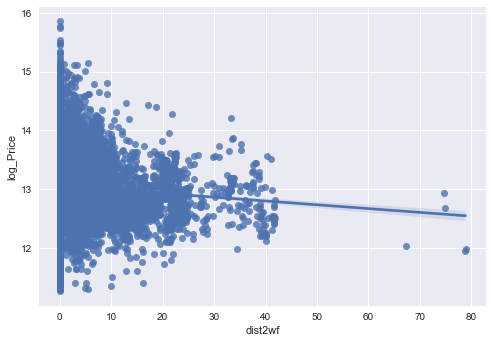

In [70]:
sns.regplot(x=house_data.dist2wf,y = house_data.log_Price);

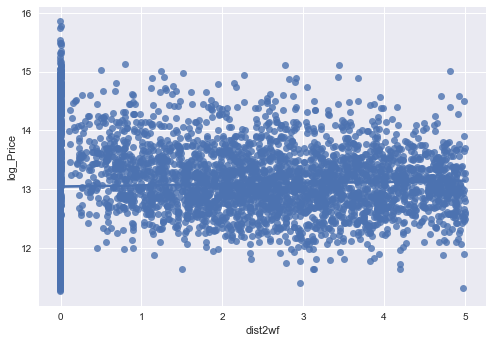

In [71]:
nearest_wf = house_data.dist2wf[house_data.dist2wf < 5]
nwf_LogPrice = house_data.log_Price[house_data.dist2wf < 5]
sns.regplot(x=nearest_wf,y = nwf_LogPrice);

**distance to waterfront seems to have an impact, imropove calculations**

### Living Area to lot Area ratio 

In [72]:
house_data['sqft_liv2lot'] = house_data.sqft_living/house_data.sqft_lot
house_data['sqft_liv2lot'].describe()

count    21596.000000
mean         0.323758
std          0.268466
min          0.000610
25%          0.156649
50%          0.247665
75%          0.407615
max          4.653846
Name: sqft_liv2lot, dtype: float64

In [73]:
print(smf.ols(formula='log_Price ~ sqft_liv2lot', data=house_data).fit().rsquared)
print(smf.ols(formula='log_Price ~ sqft_lot', data=house_data).fit().rsquared)

0.03480582900950513
0.010006376255865534


In [74]:
house_data.sqft_lot.describe()

count    2.159600e+04
mean     1.509983e+04
std      4.141355e+04
min      5.200000e+02
25%      5.040000e+03
50%      7.619000e+03
75%      1.068550e+04
max      1.651359e+06
Name: sqft_lot, dtype: float64

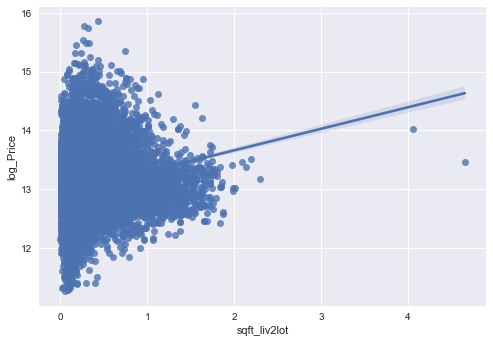

In [75]:
sns.regplot(x=house_data.sqft_liv2lot,y = house_data.log_Price);

**ratio living area-lot area has a higher $r^2$ than lot by itselve ->sure...**

### Basement yes/no

In [76]:
house_data['hasBasement'] = house_data.sqft_basement2
house_data.hasBasement[house_data.sqft_basement2 > 0] = 1
house_data.hasBasement[house_data.sqft_basement2 == 0] = 0

print(smf.ols(formula='log_Price ~ hasBasement', data=house_data).fit().rsquared)
print(smf.ols(formula='log_Price ~ sqft_basement2', data=house_data).fit().rsquared)

0.04500812825372891
0.10043061505979578


/Users/sandra/opt/anaconda3/envs/nf/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

/Users/sandra/opt/anaconda3/envs/nf/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [77]:
print(smf.ols(formula='price ~ hasBasement', data=house_data).fit().summary())

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.032
Model:                            OLS   Adj. R-squared:                  0.032
Method:                 Least Squares   F-statistic:                     723.7
Date:                Sun, 14 Jun 2020   Prob (F-statistic):          8.12e-157
Time:                        20:17:23   Log-Likelihood:            -3.0702e+05
No. Observations:               21596   AIC:                         6.140e+05
Df Residuals:                   21594   BIC:                         6.141e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
Intercept    4.871e+05   3156.178    154.322      

In [78]:
print(smf.ols(formula='log_Price ~ sqft_basement2', data=house_data).fit().summary())

                            OLS Regression Results                            
Dep. Variable:              log_Price   R-squared:                       0.100
Model:                            OLS   Adj. R-squared:                  0.100
Method:                 Least Squares   F-statistic:                     2411.
Date:                Sun, 14 Jun 2020   Prob (F-statistic):               0.00
Time:                        20:17:24   Log-Likelihood:                -15649.
No. Observations:               21596   AIC:                         3.130e+04
Df Residuals:                   21594   BIC:                         3.132e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept         12.9382      0.004   3178.

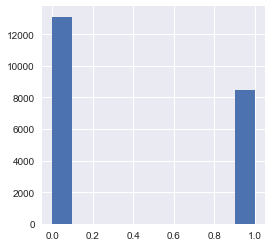

In [79]:
_=house_data.hasBasement.hist(figsize=(4,4))
plt.savefig('figures/hist_basement_yn.png')

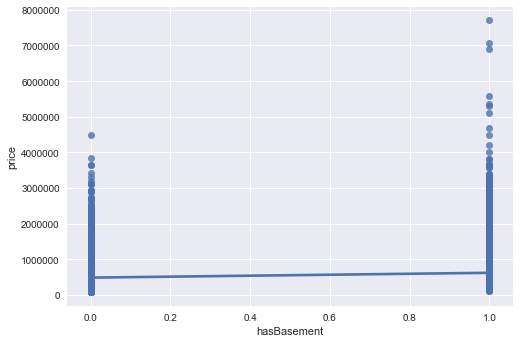

In [80]:
sns.regplot(x=house_data.hasBasement,y = house_data.price);

**although $r^2$ is lower for hasBasement than for basement size it is very usable and has a non-neglectable impact**

### Renovated-or-not Category

- Houses which has been renovated or built after 1988 are a bit more expensive than houses with renovations before

In [81]:
house_data['hasBeenRenRec'] = house_data.yr_renovated_rpl_0
house_data.hasBeenRenRec[house_data.yr_renovated_rpl_0 > 1987] = 1
house_data.hasBeenRenRec[house_data.yr_renovated_rpl_0 <= 1987] = 0
print(smf.ols(formula='log_Price ~ hasBeenRenRec', data=house_data).fit().rsquared)
print(smf.ols(formula='log_Price ~ yr_renovated_rpl_0', data=house_data).fit().rsquared)
print(smf.ols(formula='log_Price ~ yr_built', data=house_data).fit().rsquared)

0.04153731167135144
0.014897454869066906
0.0064976944625944055


/Users/sandra/opt/anaconda3/envs/nf/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

/Users/sandra/opt/anaconda3/envs/nf/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



- renovated 1999:
0.0304, 0.015

- renovated 1995:
0.037

- renovated 1990:
0.038

- renovated 1987: 
0.042

- renovated 1985:
0.040

In [82]:
smf.ols(formula='log_Price ~ hasBeenRenRec', data=house_data).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              log_Price   R-squared:                       0.042
Model:                            OLS   Adj. R-squared:                  0.041
Method:                 Least Squares   F-statistic:                     935.8
Date:                Sun, 14 Jun 2020   Prob (F-statistic):          3.11e-201
Time:                        20:17:33   Log-Likelihood:                -16333.
No. Observations:               21596   AIC:                         3.267e+04
Df Residuals:                   21594   BIC:                         3.269e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept        12.9651      0.004   2922.209      0.000      12.956      12.974
hasBeenRenRec     0.2217      0.007     30.591      0.000       0.207       0.236
==============================================================================
Omnibus:                      885.938   Durbin-Watson:                   1.970
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1084.577
Skew:                           0.458   Prob(JB):                    3.07e-236
Kurtosis:                       3.607   Cond. No.                         2.43
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [83]:
smf.ols(formula='price ~ hasBeenRenRec', data=house_data).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.028
Model:                            OLS   Adj. R-squared:                  0.028
Method:                 Least Squares   F-statistic:                     623.5
Date:                Sun, 14 Jun 2020   Prob (F-statistic):          1.09e-135
Time:                        20:17:35   Log-Likelihood:            -3.0707e+05
No. Observations:               21596   AIC:                         6.141e+05
Df Residuals:                   21594   BIC:                         6.142e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept      4.926e+05   3117.144    158.042      0.000    4.87e+05    4.99e+05
hasBeenRenRec  1.271e+05   5091.375     24.970      0.000    1.17e+05    1.37e+05
==============================================================================
Omnibus:                    19159.499   Durbin-Watson:                   1.974
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1167569.663
Skew:                           4.032   Prob(JB):                         0.00
Kurtosis:                      38.107   Cond. No.                         2.43
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

**renovated after 1987 means on average higher house prices**

### Old versus new houses

- houses built after 1987 are generally more expensive than houses built before

In [84]:
house_data.yr_built.describe()

count    21596.000000
mean      1971.000787
std         29.375460
min       1900.000000
25%       1951.000000
50%       1975.000000
75%       1997.000000
max       2015.000000
Name: yr_built, dtype: float64

In [85]:
house_data['isNew'] = house_data.yr_built
house_data.isNew[house_data.yr_built > 1987] = 1
house_data.isNew[house_data.yr_built <= 1987] = 0
print(smf.ols(formula='log_Price ~ isNew', data=house_data).fit().rsquared)
print(smf.ols(formula='log_Price ~ yr_built', data=house_data).fit().rsquared)


0.028659978762253346
0.0064976944625944055


/Users/sandra/opt/anaconda3/envs/nf/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

/Users/sandra/opt/anaconda3/envs/nf/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [86]:
smf.ols(formula='log_Price ~ isNew', data=house_data).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              log_Price   R-squared:                       0.029
Model:                            OLS   Adj. R-squared:                  0.029
Method:                 Least Squares   F-statistic:                     637.1
Date:                Sun, 14 Jun 2020   Prob (F-statistic):          1.42e-138
Time:                        20:17:40   Log-Likelihood:                -16478.
No. Observations:               21596   AIC:                         3.296e+04
Df Residuals:                   21594   BIC:                         3.298e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     12.9829      0.004   2965.049      0.000      12.974      12.991
isNew          0.1870      0.007     25.242      0.000       0.172       0.201
==============================================================================
Omnibus:                      940.932   Durbin-Watson:                   1.969
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1168.509
Skew:                           0.471   Prob(JB):                    1.83e-254
Kurtosis:                       3.642   Cond. No.                         2.42
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [87]:
smf.ols(formula='log_Price ~ yr_built', data=house_data).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              log_Price   R-squared:                       0.006
Model:                            OLS   Adj. R-squared:                  0.006
Method:                 Least Squares   F-statistic:                     141.2
Date:                Sun, 14 Jun 2020   Prob (F-statistic):           1.81e-32
Time:                        20:17:41   Log-Likelihood:                -16721.
No. Observations:               21596   AIC:                         3.345e+04
Df Residuals:                   21594   BIC:                         3.346e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     10.2003      0.240     42.559      0.000       9.730      10.670
yr_built       0.0014      0.000     11.884      0.000       0.001       0.002
==============================================================================
Omnibus:                      905.424   Durbin-Watson:                   1.964
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1134.656
Skew:                           0.455   Prob(JB):                    4.10e-247
Kurtosis:                       3.659   Cond. No.                     1.32e+05
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.32e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

# Multible Variable choise

In [88]:
#all the original variables
model = 'price ~ bedrooms+ bathrooms+ sqft_living+ sqft_lot+ floors+ waterfront+ view+\
        condition+ grade+sqft_above+ yr_built+ yr_renovated+zipcode+lat+ long+\
        sqft_living15+ sqft_lot15+sqft_basement2'
smf.ols(formula=model,data=house_data).fit().rsquared

0.7019825299659141

In [89]:
# log of price against all original variables
model = 'log_Price ~ bedrooms+ bathrooms+ sqft_living+ sqft_lot+ floors+ waterfront+ view+\
        condition+ grade+sqft_above+ yr_built+ yr_renovated+zipcode+lat+ long+\
        sqft_living15+ sqft_lot15+sqft_basement2'
smf.ols(formula=model,data=house_data).fit().rsquared


0.7717790569953682

In [90]:
# all most important variables
model = 'log_Price ~ bathrooms+ sqft_living+view+\
        grade+sqft_above+ \
        sqft_living15'
smf.ols(formula=model,data=house_data).fit().rsquared

0.5827342459896807

In [91]:
# minimize from all to most important + important additionals
model = 'log_Price ~ bedrooms+ sqft_living+ condition+waterfront+ hasBeenRenRec+view+\
         grade+ yr_built+ zipcode+lat+sqft_living15+  hasBasement+dist2wf'
modelFit = smf.ols(formula=model,data=house_data).fit()

modelFit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              log_Price   R-squared:                       0.769
Model:                            OLS   Adj. R-squared:                  0.769
Method:                 Least Squares   F-statistic:                     4900.
Date:                Sun, 14 Jun 2020   Prob (F-statistic):               0.00
Time:                        20:17:59   Log-Likelihood:                -887.18
No. Observations:               19163   AIC:                             1802.
Df Residuals:                   19149   BIC:                             1912.
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept         3.3210      3.878      0.856      0.392      -4.281      10.923
bedrooms          0.0003      0.003      0.126      0.900      -0.005       0.005
sqft_living       0.0002   4.15e-06     38.991      0.000       0.000       0.000
condition         0.0734      0.003     23.278      0.000       0.067       0.080
waterfront        0.3992      0.023     17.204      0.000       0.354       0.445
hasBeenRenRec     0.1543      0.006     26.740      0.000       0.143       0.166
view              0.0645      0.003     22.698      0.000       0.059       0.070
grade             0.1715      0.003     61.425      0.000       0.166       0.177
yr_built         -0.0041   9.72e-05    -42.178      0.000      -0.004      -0.004
zipcode          -0.0005      4e-05    -13.258      0.000      -0.001      -0.000
lat               1.4214      0.014     99.109      0.000       1.393       1.450
sqft_living15   8.02e-05   4.48e-06     17.913      0.000    7.14e-05     8.9e-05
hasBasement       0.0490      0.004     11.812      0.000       0.041       0.057
dist2wf          -0.0002      0.000     -0.604      0.546      -0.001       0.001
==============================================================================
Omnibus:                      348.221   Durbin-Watson:                   1.997
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              723.173
Skew:                           0.026   Prob(JB):                    9.22e-158
Kurtosis:                       3.950   Cond. No.                     2.08e+08
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.08e+08. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

# Model Run

# Summary
- Most important influencer of price is the size of the house
- Also having a basement or not is important: Houses without basements are on average 135400 USD cheaper than houses with basement
- Waterfront objects are expensive: houses with waterfront view are an average twice as expensive as houses without. The price of houses without waterfront view decreases with distance to the water side.
- Houses renovated within the previous ~30 yrs are more expensive then houses without renovation or which has been renoved befor 1988. On average, a recently renovated house coast 127100 USD more than a non-renovated house.

# Outlook
- It still needs to be tested how good the model performance is.
- The model may require some improvements after testing.
- It still needs to be shown, which kind of objects fullfil the criteria price beeing within +/- 20% of mean house price.
- The impact that distance to water areas has on the price should be improved by using geographical positions of water areas. => Calculating the real distance of houses to waterfront instead of using distance to an waterview object as proxy.
- A longer time series can help to identify whether the season and how much the inflation rate has an impact on prices.
- Also the impact of rural vs. urban location could be investigated in further analysis.